In [134]:
import baltic as bt
import pandas as pd
import arviz as az

from datetime import datetime as dt
from datetime import timedelta
import time
from io import StringIO
import altair as alt
from zipfile import ZipFile
import math
import re
import random


import sys, subprocess, glob, os, shutil, re, importlib
from subprocess import call
import imp
from scipy.stats import gaussian_kde
import geopandas

%matplotlib inline
import matplotlib as mpl
from matplotlib import pyplot as plt
import seaborn as sns
import matplotlib.patheffects as path_effects
import matplotlib.lines as mlines
from matplotlib.font_manager import FontProperties
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.colors as clr
from matplotlib import rc
from matplotlib.gridspec import GridSpec

import textwrap as textwrap
from textwrap import wrap

import numpy as np
from scipy.special import binom

from altair import datum
import arviz as az
from scipy.stats import gaussian_kde

alt.data_transformers.disable_max_rows()


DataTransformerRegistry.enable('default')

In [135]:
#need to convert the decimal dates back to calendar dates 
def convert_partial_year(number):

    year = int(number)
    d = timedelta(days=(number - year)*(365 + is_leap(year)))
    day_one = dt(year,1,1)
    date = d + day_one
    date = dt.strftime(date, '%Y-%m-%d')
    return date

In [136]:
#need to convert the decimal dates back to calendar dates 
def convert_persistence(number):

    
    d = timedelta(days=(number)*(365))
    
    return d.total_seconds()


In [137]:
def is_leap(number):
    if number == 2024:
        leap = 1
    else:
        leap = 0
    return leap


In [138]:
def convert_format(number):
    date = dt.strptime(number, '%Y-%m-%d')
    date = date - timedelta(days=date.weekday())
    return date

In [139]:
def convert_format_month(number):
    date = dt.strptime(number, '%Y-%m-%d')
    date = dt.strftime(date, '%Y-%m')
    return date

In [140]:
def convert_format_month_only(number):
    date = dt.strptime(number, '%Y-%m-%d')
    date = dt.strftime(date, '%m')
    return date

In [141]:
def convertDate(x,start,end):
    """ Converts calendar dates between given formats """
    return dt.strftime(dt.strptime(x,start),end)

In [142]:
def decimal_to_days(decimal_value):
    days = int(decimal_value * 365)
    return days

In [143]:
def get_taxa_lines(tree_path):    

    lines_to_write = ""
    with open(trees, 'rU') as infile:
        for line in infile: ## iterate through each line
            if 'state' not in line.lower(): #going to grab all the interesting stuff in the .trees file prior to the newick tree strings
                lines_to_write = lines_to_write + line

    return(lines_to_write)


In [144]:
def get_burnin_value(tree_path, burnin_percent):
    with open(tree_path, 'rU') as infile:
        numtrees = 0
        for line in infile: ## iterate through each line
            if 'state' in line.lower(): #going to grab all the interesting stuff in the .trees file prior to the newick tree strings
                numtrees += 1
    
    burnin = numtrees * burnin_percent
    return(burnin)



In [145]:
#making decimal date from string dates adapted from stackoverflow (thank you coding geniuses)
def toYearFraction(date):
    def sinceEpoch(date): # returns seconds since epoch
        return time.mktime(date.timetuple())
    s = sinceEpoch

    year = date.year
    startOfThisYear = dt(year=year, month=1, day=1)
    startOfNextYear = dt(year=year+1, month=1, day=1)

    yearElapsed = s(date) - s(startOfThisYear)
    yearDuration = s(startOfNextYear) - s(startOfThisYear)
    fraction = yearElapsed/yearDuration

    return date.year + fraction


In [146]:
def enumerate_migration_events(tree, traitType):
        
    output_dict = {}
    migration_events_counter = 0
    #tree_leaves = [leaf for leaf in tree.getExternal()]
    for k in tree.Objects:
        
        if traitType not in k.traits:
            trait = "root"
        else:
            trait = str(k.traits[traitType])
            
        parent_node = k.parent
        
        if traitType not in parent_node.traits:
            parent_trait = "root"
        
        # only write out migration events that are not from root to deme
        else:
            parent_trait = str(parent_node.traits[traitType])
        
        if (trait != parent_trait) and (parent_trait != "root"):
            migration_events_counter += 1

            migration_event = parent_trait + "-to-" + trait
            migration_date = parent_node.absoluteTime + (k.absoluteTime - parent_node.absoluteTime) *random.uniform(0,1)
            parent_tmrca = parent_node.absoluteTime 
            chain_tmrca = k.absoluteTime
            size_of_chain =len([leaf for leaf in parent_node.leaves])
            leaf_list = []
            for leaf in tree.getExternal():
                if leaf.name in parent_node.leaves:
                    leaf_list.append(leaf)
            chain_latest_tip = max(x.absoluteTime for x in leaf_list)
                    
            # write to output dictionary
            output_dict[migration_events_counter] = {"type":migration_event, "date":migration_date, "parent_tmrca":parent_tmrca,
                                                     "chain_tmrca": chain_tmrca, "chain_latest_tip": chain_latest_tip, "size_of_chain":size_of_chain,
                                                     "parent_host":parent_trait,
                                                     "child_host": trait, "tree_length": sum([x.length for x in tree.Objects])}

    return(output_dict)


In [147]:
#counts all migration events and records parent and child nodes
def run_mig_counts(all_trees, traitType):
    start_time = time.time()
    with open(all_trees, "r") as infile:

        tree_counter = 0
        trees_processed = 0
        migrations_dict = {}

        for line in infile:
            if 'tree STATE_' in line:
                tree_counter += 1

                if tree_counter > burnin:
                    temp_tree = StringIO(taxa_lines + line)
                    
                    tree = bt.loadNexus(temp_tree, absoluteTime = False)
                    tree.setAbsoluteTime(2024.9467)
                    trees_processed += 1

                    # iterate through the tree and pull out all migration events
                    migrations_dict[tree_counter] = enumerate_migration_events(tree, traitType)

    # print the amount of time this took
    total_time_seconds = time.time() - start_time
    total_time_minutes = total_time_seconds/60
    print("this took", total_time_seconds, "seconds (", total_time_minutes," minutes) to run on", trees_processed, "trees")
   
    """this will generate a multi-index dataframe from the migrations dictionary"""
    migrations_df = pd.DataFrame.from_dict({(i,j): migrations_dict[i][j] 
                           for i in migrations_dict.keys() 
                           for j in migrations_dict[i].keys()},
                       orient='index')

    migrations_df.reset_index(inplace=True)
    migrations_df.rename(columns={'level_0': 'tree_number', 'level_1': 'migration_event_number'}, inplace=True)
    
    return(migrations_df)

In [148]:
def return_proportions_dataframe(input_df, time_unit):
    output_df = pd.DataFrame()

    
    for tree_number in set(input_df['tree_number'].tolist()):
        local_df1 = input_df[input_df['tree_number'] == tree_number]
        
        for v in list(set(input_df['type'].tolist())):
            local_df = local_df1[local_df1['type'] == v]
            total_transitions = len(local_df)

            for item in set(input_df[time_unit].tolist()):
                local_df2 = local_df[local_df[time_unit] == item]
                transitions_in_time_unit = len(local_df2)

                   
                if total_transitions != 0 :
                    prop_transitions_in_time_unit = transitions_in_time_unit/total_transitions
                else:
                    prop_transitions_in_time_unit = 0
                    


                to_add = pd.DataFrame({"migration_direction":[v],time_unit:[item],"tree_number":[tree_number], 
                                       "total_transitions":[total_transitions],
                                       "transitions_in_time_interval":[transitions_in_time_unit],
                                      "proportion_transitions_in_time_interval":[prop_transitions_in_time_unit]})
                output_df = output_df.append(to_add)
            
    return(output_df)


In [149]:
#read in the introdcution rate
def read_in_forward_migration_rates_mascot(log_file_path):
    
    mig_rates_dict = {"sample":[]}
    
    with open(log_file_path, "r") as infile:
        line_number = 0
        for line in infile:
            #print(line_number)
            line_number += 1
            if not line.startswith("#"):  # log combiner will sometimes put the entire xml at the start of the log file
                # use the first line to find the migration rate columns
                
            # use the first line to find the migration rate columns
                if "posterior" in line:
                    all_cols = line.split("\t")
                    mig_column_indices = []   # list to store column indices
                    mig_key = {}   # dictionary to store the column index to map to column name

                    for i in range(len(all_cols)):
                        col = all_cols[i]
                        if "immigrationRate" in col:
                            mig_column_indices.append(i)

                    # make an empty dictionary to store Nes and generate dictionary to convert index to name
                    for n in mig_column_indices:
                        name = line.split("\t")[n]
                        interval = name.split(".")[1]# the syntax here is "NeLog.state01" where 0 is deme and 1 is interval 1
                        #interval = name.split(".")[2]
                       
                        mig_key[n] = name
                        mig_rates_dict[name] = []


                # read in actual parameter estimates and store in dictionary
                else:
                    sample = line.split("\t")[0]
                    mig_rates_dict["sample"].append(sample)

                    for index in mig_column_indices:
                        name = mig_key[index]
                        mig_rates_dict[name].append(line.split("\t")[index])
                    
                
                
                
    return(mig_rates_dict)

In [150]:
# make a new dataframe that summarizes the 95% HPD estimate with mean for each deme and interval 
def generate_summary_mig_df(input_df):
    
    
    new_df = pd.DataFrame()

    for i in input_df.columns.tolist():
        if "immigrationRate." in i:
            interval = i.split(".")[1]
            local_series = input_df[i].astype('float').to_numpy()
            mean_log = local_series.mean()
            median_log = np.median(local_series)
            mean_linear = math.exp(mean_log)
            hpd_95 = az.hdi(local_series, 0.95)
            lower_hpd_log_95 = hpd_95[0]
            lower_hpd_linear_95 = math.exp(lower_hpd_log_95)
            upper_hpd_log_95 = hpd_95[1]
            upper_hpd_linear_95 = math.exp(upper_hpd_log_95)
            hpd_50 = az.hdi(local_series, 0.50)
            lower_hpd_log_50 = hpd_50[0]
            lower_hpd_linear_50 = math.exp(lower_hpd_log_50)
            upper_hpd_log_50 = hpd_50[1]
            upper_hpd_linear_50 = math.exp(upper_hpd_log_50)
            
            
            try:
                local_df = pd.DataFrame.from_dict({"interval":interval, "mean_mig_log":mean_log,"mean_mig_linear":mean_linear, 
                                                   "median_mig_log" : median_log, 
                                                   "upper_hpd_log_95":upper_hpd_log_95,"lower_hpd_log_95":[lower_hpd_log_95], 
                                                   "upper_hpd_log_50":upper_hpd_log_50,"lower_hpd_log_50":lower_hpd_log_50,
                                                   "upper_hpd_linear":upper_hpd_linear_95,"lower_hpd_linear":lower_hpd_linear_95,
                                                   "upper_hpd_linear_50":upper_hpd_linear_50, "lower_hpd_linear_50":lower_hpd_linear_50,
                                                  })
                new_df = new_df.append(local_df)
                #print(new_df)
            except:
                pass
            
   
            

            
    return(new_df)

In [151]:
def read_in_Ne_changes_mascot(log_file_path):
    
    Ne_skyline_dict = {"sample":[]}
    
    with open(log_file_path, "r") as infile:
        line_number = 0
        for line in infile:
            line_number += 1
            if not line.startswith("#"):  # log combiner will sometimes put the entire xml at the start of the log file
                # use the first line to find the migration rate columns
                #print(line)
            # use the first line to find the migration rate columns
                if "posterior" in line:
                    all_cols = line.split("\t")
                    Ne_column_indices = []   # list to store column indices
                    Nes_key = {}   # dictionary to store the column index to map to column name

                    for i in range(len(all_cols)):
                        col = all_cols[i]
                        if "Ne." in col:
                            Ne_column_indices.append(i)

                    # make an empty dictionary to store Nes and generate dictionary to convert index to name
                    for n in Ne_column_indices:
                        name = line.split("\t")[n]
                        #deme = name.split(".")[1]# the syntax here is "Ne_region.1" where region is deme and 1 is interval 1
                        interval = name.split(".")[1]
                       
                        Nes_key[n] = name
                        Ne_skyline_dict[name] = []


                # read in actual parameter estimates and store in dictionary
                else:
                    sample = line.split("\t")[0]
                    Ne_skyline_dict["sample"].append(sample)

                    for index in Ne_column_indices:
                        name = Nes_key[index]
                        Ne_skyline_dict[name].append(line.split("\t")[index])
                    
                
    return(Ne_skyline_dict)

In [152]:
# make a new dataframe that summarizes the 95% HPD estimate with mean for each deme and interval 
def generate_summary_ne_df(input_df):
    
    
    new_df = pd.DataFrame()

    for i in input_df.columns.tolist():
        if "Ne." in i:
            #deme = i.split(".")[1]
           # print(deme)
            #interval = 
            #print(interval)
#             if "\n" in i.split(".")[2]:
#                 interval = i.split(".")[2][0:2]
#             else:
            interval = i.split(".")[1]
           # print(interval)
            #print(interval)
            #print(i)
            #next_interval = int(interval)+1
            local_series = input_df[i].astype('float').to_numpy()
            #print(local_series)
            mean_log = local_series.mean()
            median_log = np.median(local_series)
            mean_linear = math.exp(mean_log)
            hpd_95 = az.hdi(local_series, 0.95)
            lower_hpd_log_95 = hpd_95[0]
            lower_hpd_linear_95 = math.exp(lower_hpd_log_95)
            upper_hpd_log_95 = hpd_95[1]
            upper_hpd_linear_95 = math.exp(upper_hpd_log_95)
            hpd_50 = az.hdi(local_series, 0.50)
            lower_hpd_log_50 = hpd_50[0]
            lower_hpd_linear_50 = math.exp(lower_hpd_log_50)
            upper_hpd_log_50 = hpd_50[1]
            upper_hpd_linear_50 = math.exp(upper_hpd_log_50)
            

            
            try:
                local_df = pd.DataFrame.from_dict({"interval":interval, "mean_Ne_log":mean_log,"mean_Ne_linear":mean_linear, 
                                                   "median_Ne_log" : median_log, 
                                                   "upper_hpd_log_95":upper_hpd_log_95,"lower_hpd_log_95":[lower_hpd_log_95], 
                                                   "upper_hpd_log_50":upper_hpd_log_50,"lower_hpd_log_50":lower_hpd_log_50,
                                                   "upper_hpd_linear":upper_hpd_linear_95,"lower_hpd_linear":lower_hpd_linear_95,
                                                   "upper_hpd_linear_50":upper_hpd_linear_50, "lower_hpd_linear_50":lower_hpd_linear_50,
                                                  })
                new_df = new_df.append(local_df)
                #print(new_df)
            except:
                pass
            
    return(new_df)

In [153]:
trees =  "../multitree_coalescent/results/deduped_smoothed_case_01_22.trees"
log_file_path = "../multitree_coalescent/results/multicoal_smoothed_multicoal_case_prior_la_clusters_with_metadata_01_22.log"



In [154]:
all_trees = trees
burnin_percent = 0.3
taxa_lines = get_taxa_lines(all_trees)
burnin = get_burnin_value(all_trees, burnin_percent)
print(burnin)



138.29999999999998


In [155]:
#identify each migration jump across posterior set of trees
migrations_df = run_mig_counts(all_trees, traitType = "obs")

this took 38.66550874710083 seconds ( 0.6444251457850139  minutes) to run on 323 trees


In [156]:
migrations_df.head()

,tree_number,migration_event_number,type,date,parent_tmrca,chain_tmrca,chain_latest_tip,size_of_chain,parent_host,child_host,tree_length
0,139,1,0.0-to-1.0,2022.523968,2022.484706,2022.5739,2022.5739,1,0.0,1.0,239.062381
1,139,2,0.0-to-1.0,2022.531359,2022.454058,2022.5629,2022.5629,1,0.0,1.0,239.062381
2,139,3,0.0-to-1.0,2022.573757,2022.573601,2022.5739,2022.5739,1,0.0,1.0,239.062381
3,139,4,0.0-to-1.0,2022.619775,2022.599833,2022.6260,2022.6260,1,0.0,1.0,239.062381
4,139,5,0.0-to-1.0,2022.559058,2022.558636,2022.5629,2022.5629,1,0.0,1.0,239.062381


In [157]:
migrations_df['calendar_date'] = migrations_df.date.map(convert_partial_year)
migrations_df['year-week'] = migrations_df['calendar_date'].map(convert_format)


In [158]:
migrations_df.head()

,tree_number,migration_event_number,type,date,parent_tmrca,chain_tmrca,chain_latest_tip,size_of_chain,parent_host,child_host,tree_length,calendar_date,year-week
0,139,1,0.0-to-1.0,2022.523968,2022.484706,2022.5739,2022.5739,1,0.0,1.0,239.062381,2022-07-11,2022-07-11
1,139,2,0.0-to-1.0,2022.531359,2022.454058,2022.5629,2022.5629,1,0.0,1.0,239.062381,2022-07-13,2022-07-11
2,139,3,0.0-to-1.0,2022.573757,2022.573601,2022.5739,2022.5739,1,0.0,1.0,239.062381,2022-07-29,2022-07-25
3,139,4,0.0-to-1.0,2022.619775,2022.599833,2022.6260,2022.6260,1,0.0,1.0,239.062381,2022-08-15,2022-08-15
4,139,5,0.0-to-1.0,2022.559058,2022.558636,2022.5629,2022.5629,1,0.0,1.0,239.062381,2022-07-24,2022-07-18


In [159]:
migrations_for_plot = migrations_df.groupby(["migration_event_number"])["date",'parent_tmrca', "chain_tmrca", "chain_latest_tip", "size_of_chain"].median().reset_index()
migrations_for_plot = migrations_for_plot.sort_values(by=['date']).reset_index()

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2017099716.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  migrations_for_plot = migrations_df.groupby(["migration_event_number"])["date",'parent_tmrca', "chain_tmrca", "chain_latest_tip", "size_of_chain"].median().reset_index()


In [160]:
migrations_for_plot["calendar_date"] = migrations_for_plot.date.map(convert_partial_year)
migrations_for_plot['month'] = migrations_for_plot['calendar_date'].map(convert_format_month_only)

In [161]:
migrations_for_plot.head()

,index,migration_event_number,date,parent_tmrca,chain_tmrca,chain_latest_tip,size_of_chain,calendar_date,month
0,76,77,2022.420674,2022.412314,2022.429984,2022.6999,9.0,2022-06-03,06
1,46,47,2022.427217,2022.417973,2022.435918,2023.5520,17.0,2022-06-05,06
2,70,71,2022.433992,2022.422312,2022.443725,2022.6972,3.0,2022-06-08,06
3,61,62,2022.434794,2022.421303,2022.444827,2022.7410,9.0,2022-06-08,06
4,31,32,2022.436162,2022.427703,2022.446217,2022.8561,18.0,2022-06-09,06


In [162]:
migrations_df.groupby(["migration_event_number"])["date",'parent_tmrca', "chain_tmrca", "chain_latest_tip", "size_of_chain"]





/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2972131145.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  migrations_df.groupby(["migration_event_number"])["date",'parent_tmrca', "chain_tmrca", "chain_latest_tip", "size_of_chain"]


In [163]:
migrations_for_plot.head()

,index,migration_event_number,date,parent_tmrca,chain_tmrca,chain_latest_tip,size_of_chain,calendar_date,month
0,76,77,2022.420674,2022.412314,2022.429984,2022.6999,9.0,2022-06-03,06
1,46,47,2022.427217,2022.417973,2022.435918,2023.5520,17.0,2022-06-05,06
2,70,71,2022.433992,2022.422312,2022.443725,2022.6972,3.0,2022-06-08,06
3,61,62,2022.434794,2022.421303,2022.444827,2022.7410,9.0,2022-06-08,06
4,31,32,2022.436162,2022.427703,2022.446217,2022.8561,18.0,2022-06-09,06


In [164]:
migrations_for_export = migrations_for_plot.copy()

In [165]:
migrations_for_export['length_of_chain'] = migrations_for_export.chain_latest_tip - migrations_for_export.date
migrations_for_export['length_of_chain_days'] = migrations_for_export.length_of_chain.apply(decimal_to_days)
migrations_for_export['calendar_date_of_import'] = migrations_for_export.date.map(convert_partial_year)
migrations_for_export['latest_case_of_chain_calendar_date'] = migrations_for_export.chain_latest_tip.map(convert_partial_year)
migrations_for_export= migrations_for_export[["migration_event_number", "calendar_date_of_import","latest_case_of_chain_calendar_date", "size_of_chain", "length_of_chain_days"]]


In [166]:
migrations_for_export.to_csv("importation_transmission_chains.csv")


In [167]:
migrations_for_export

,migration_event_number,calendar_date_of_import,latest_case_of_chain_calendar_date,size_of_chain,length_of_chain_days
0,77,2022-06-03,2022-09-13,9.0,101
1,47,2022-06-05,2023-07-21,17.0,410
2,71,2022-06-08,2022-09-12,3.0,96
3,62,2022-06-08,2022-09-28,9.0,111
4,32,2022-06-09,2022-11-09,18.0,153
...,...,...,...,...,...
282,188,2024-08-21,2024-08-29,1.0,7
283,150,2024-09-09,2024-10-06,3.0,26
284,195,2024-09-16,2024-11-15,2.0,60
285,189,2024-09-17,2024-09-25,1.0,7


In [168]:
migration_rates_f = read_in_forward_migration_rates_mascot(log_file_path)
mig_df_f = pd.DataFrame.from_dict(migration_rates_f)

burnin_percent = 0.3
print(len(mig_df_f))
rows_to_remove = int(len(mig_df_f)* burnin_percent)
mig_df_f = mig_df_f.iloc[rows_to_remove:]

print(len(mig_df_f))
mig_df_f = mig_df_f.reset_index()
mig_df_f.head()

4449
3115


,index,sample,immigrationRate.1,immigrationRate.2,immigrationRate.3,immigrationRate.4,immigrationRate.5,immigrationRate.6,immigrationRate.7,immigrationRate.8,...,immigrationRate.129,immigrationRate.130,immigrationRate.131,immigrationRate.132,immigrationRate.133,immigrationRate.134,immigrationRate.135,immigrationRate.136,immigrationRate.137,immigrationRate.138
0,1334,66700000,-1.4283361361286757,-0.46485542994196016,0.6085976830182345,-0.09508524571561049,-0.4878072571131238,-0.9579833162812611,-1.0571928323517727,-0.5220745287252839,...,2.493151405340156,2.1333669956526875,2.940099604557461,2.3599861169066028,2.5442182497189285,2.782769095293822,2.6763615846942153,2.237864358771005,2.858790529847559,2.743341411614092
1,1335,66750000,0.9373411360414724,1.294170581919156,1.0204309947648615,0.543059142800109,-0.04062008232317779,-1.6521575051898314,-1.1130049838630307,-1.585196946172903,...,2.8575957976515003,2.7104061585565105,2.98261332892712,2.882878632849613,2.0628633356800767,2.3579043235942074,2.0760533931371272,2.1676748192519955,2.1675601195821512,1.4754657378307108
2,1336,66800000,1.0483938359735634,0.6838521532420206,0.777687213417006,0.44830175177429316,0.5413564369163945,1.0211465501039911,-0.44864750279042986,-0.9843215226283081,...,2.5256035268011416,2.2848025329196777,2.482422116676094,1.8878854756418622,2.015647703599142,2.694092595324931,1.9936580118536162,1.522257338005721,0.6622229443290322,1.570888922251831
3,1337,66850000,-1.3291360147614155,-1.209228417618184,-1.1389887651938333,-0.27128686745303615,-0.42191840732051306,-0.4062120315291242,0.11899659448191773,-0.11653498280636129,...,2.461258550178066,2.5160203283179174,3.502378241069932,3.405345058482367,3.110513884281638,2.7549612299319,3.2862865771964156,2.80808179924075,2.8412315238288492,2.2266112343610778
4,1338,66900000,-1.0122046350453948,-0.6716735095728821,-0.34619350614397604,-0.2606446272992706,-0.8470858803141886,-0.9300928487428134,-0.7524168789514294,-1.1855275125306284,...,2.710677691321528,2.7593719829312406,2.9242813382761796,3.339462961048558,3.6741321038190624,3.366951839599576,2.7227945831369333,2.627521748626604,2.9929548032899196,2.7174227542460043


In [169]:
mig_summary = generate_summary_mig_df(mig_df_f)


/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/304284953.py:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/304284953.py:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/304284953.py:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/304284953.py:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/304284953.py:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/304284953.py:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/304284953.py:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/304284953.py:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var

In [170]:
test_mig = mig_summary
test_mig['days'] = (test_mig.interval.astype(int))*7
test_mig['date'] = dt.strptime("2024-12-12",  "%Y-%m-%d") - test_mig.days.map(timedelta)
test_mig["decimal_date"]= test_mig.date.map(toYearFraction)

In [171]:
test_mig.head()

,interval,mean_mig_log,mean_mig_linear,median_mig_log,upper_hpd_log_95,lower_hpd_log_95,upper_hpd_log_50,lower_hpd_log_50,upper_hpd_linear,lower_hpd_linear,upper_hpd_linear_50,lower_hpd_linear_50,days,date,decimal_date
0,1,-0.606085,0.545482,-0.538128,1.811774,-3.392809,0.483221,-1.178409,6.121298,0.033614,1.621288,0.307768,7,2024-12-05,2024.926230
0,2,-0.598220,0.549789,-0.522949,1.734311,-3.142245,0.377117,-1.183036,5.665025,0.043186,1.458074,0.306347,14,2024-11-28,2024.907104
0,3,-0.579932,0.559937,-0.506013,1.547813,-3.129088,0.301370,-1.225017,4.701176,0.043758,1.351710,0.293753,21,2024-11-21,2024.887978
0,4,-0.552191,0.575687,-0.492920,1.618991,-2.790347,0.191129,-1.297190,5.047996,0.061400,1.210616,0.273299,28,2024-11-14,2024.868852
0,5,-0.507751,0.601847,-0.426653,1.559658,-2.597044,0.423113,-1.010034,4.757193,0.074493,1.526707,0.364207,35,2024-11-07,2024.849727


In [172]:
Ne_skyline = read_in_Ne_changes_mascot(log_file_path)

In [173]:
Ne_df = pd.DataFrame.from_dict(Ne_skyline)
print(len(Ne_df))
Ne_df

burnin_percent = 0.3
print(len(Ne_df))
rows_to_remove = int(len(Ne_df)* burnin_percent)
Ne_df = Ne_df.iloc[rows_to_remove:]

print(len(Ne_df))
Ne_df = Ne_df.reset_index()
Ne_df.head()

4449
4449
3115


,index,sample,Ne.1,Ne.2,Ne.3,Ne.4,Ne.5,Ne.6,Ne.7,Ne.8,...,Ne.130,Ne.131,Ne.132,Ne.133,Ne.134,Ne.135,Ne.136,Ne.137,Ne.138,Ne.139
0,1334,66700000,-0.4150492051091268,-1.6486474195806042,-0.21226787930151833,-1.0388731392194992,0.4503062332291473,1.6592135977126616,-0.6016601666415693,-1.4606176795731745,...,0.9934582850687185,-0.8799907487007589,-0.7749585974519368,-3.2692068618142867,-2.986583475609112,-3.4963680260578243,-4.07409175415696,-3.934615484141743,-3.6423136320674363,-2.1114730944822333
1,1335,66750000,-3.121420831197207,-2.9812271622183864,-2.0550811206424937,-0.757269839346789,-0.2548725711791453,0.013937288113646983,-0.22107789977662876,-1.6564319616023484,...,1.0665457118237456,-1.0460954831239502,-0.18642644004509076,-2.3443642886180838,-1.998287116130621,-3.922454808163583,-3.9296788852167945,-3.2653387459411807,-1.9873012899395701,-2.218165903320699
2,1336,66800000,-3.0621602559055874,-3.0442725264941397,-2.500179451779213,0.45805921972253605,2.1987529291897268,2.9419986751771994,0.5842782068408559,0.1663906530648381,...,0.5319908086922801,-1.4747410112197725,-0.07038254712550668,-1.8261312878512734,-4.070300009581117,-4.358258234061046,-4.775973198323807,-4.240421037483388,-3.420015389775883,-1.249489881244836
3,1337,66850000,-0.9267055027591731,-2.073725770925092,-0.11620036695987819,0.33775727722827353,0.8783187290142405,0.31105615533046505,1.9447586222774824,1.7575038750783716,...,0.8725293322635398,-0.18098673475097468,-0.43796290298533097,-2.338004102534577,-2.2876650472042104,-2.4427382846010706,-3.9964116106358096,-3.4587398068797413,-1.83126089072077,-1.2859032671393118
4,1338,66900000,-2.0291882239609826,-1.7167622668345137,-0.8820287533445242,0.6932068815822862,-0.23022994024680069,-0.2554833693127013,-0.09465608448414907,-1.1772066904063456,...,1.3682461341340664,-0.8871183348190032,-0.20536640847336876,-2.5795714745019165,-2.1548824289767636,-2.657604200818937,-2.3079800716059564,-3.2009902686235594,-2.5553150350999703,-2.33163191031504


In [174]:
ne_summary = generate_summary_ne_df(Ne_df)
test_ne = ne_summary
test_ne['days'] = (test_ne.interval.astype(int))*7
test_ne['date'] = dt.strptime("2024-12-12",  "%Y-%m-%d") - test_ne.days.map(timedelta)
test_ne["decimal_date"]= test_ne.date.map(toYearFraction)

columns = ["mean_Ne_linear", "upper_hpd_linear_50","lower_hpd_linear_50", "lower_hpd_linear", "upper_hpd_linear"]
for column in columns:
    # Create a new column for the moving average
    test_ne[f'{column}_MA'] = test_ne[column].rolling(5, min_periods =1).mean()

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2461224685.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2461224685.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2461224685.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2461224685.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)


/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2461224685.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2461224685.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2461224685.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/2461224685.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_df = new_df.append(local_df)


In [175]:
test_ne.head()

,interval,mean_Ne_log,mean_Ne_linear,median_Ne_log,upper_hpd_log_95,lower_hpd_log_95,upper_hpd_log_50,lower_hpd_log_50,upper_hpd_linear,lower_hpd_linear,upper_hpd_linear_50,lower_hpd_linear_50,days,date,decimal_date,mean_Ne_linear_MA,upper_hpd_linear_50_MA,lower_hpd_linear_50_MA,lower_hpd_linear_MA,upper_hpd_linear_MA
0,1,-1.879338,0.152691,-2.071727,1.301444,-4.562602,-1.362572,-3.183664,3.674600,0.010435,0.256001,0.041434,7,2024-12-05,2024.926230,0.152691,0.256001,0.041434,0.010435,3.674600
0,2,-2.165192,0.114728,-2.353711,0.594485,-4.544902,-1.567152,-3.202561,1.812097,0.010621,0.208639,0.040658,14,2024-11-28,2024.907104,0.133710,0.232320,0.041046,0.010528,2.743349
0,3,-1.690222,0.184479,-1.820259,1.046744,-4.105920,-1.219496,-2.817374,2.848361,0.016475,0.295379,0.059763,21,2024-11-21,2024.887978,0.150633,0.253340,0.047285,0.012510,2.778353
0,4,-1.106968,0.330560,-1.219375,1.491054,-3.454782,-0.610536,-2.194642,4.441776,0.031594,0.543060,0.111398,28,2024-11-14,2024.868852,0.195614,0.325770,0.063313,0.017281,3.194208
0,5,-0.663297,0.515150,-0.742456,1.762524,-2.919192,-0.068461,-1.562120,5.827129,0.053977,0.933830,0.209691,35,2024-11-07,2024.849727,0.259522,0.447382,0.092589,0.024620,3.720793


In [176]:
colors = ["#D0A854",
          "#2664A5",
          "#A76BB1",
          "#D07954",
          "#356D4C",
          "#B9B9B9"
         ]

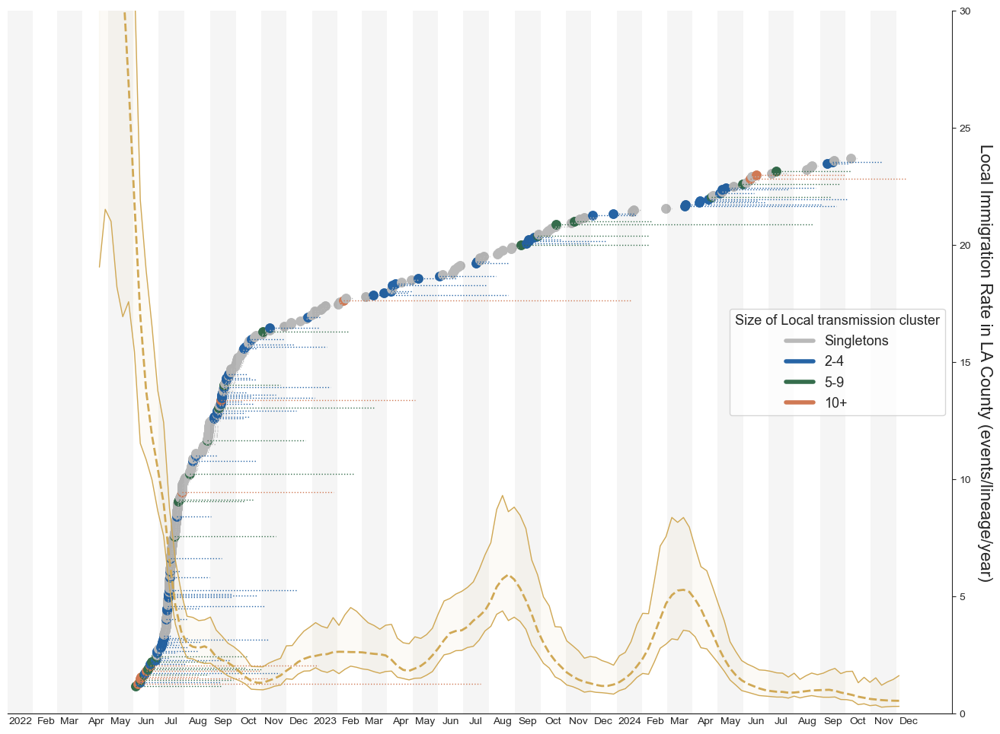

In [177]:
fig,ax = plt.subplots(figsize=(16,12),facecolor='w')


    
# set blank white face for background    
ax.set_facecolor('white')
# remove grid 
ax.grid(False)


for index, values in migrations_for_plot.iterrows():
   # print(index)
    clust = index + 10
    if values.size_of_chain <2:
        col = colors[5]
    elif (values.size_of_chain >1) & (values.size_of_chain <5):
        col = colors[1]
    elif (values.size_of_chain >4) & (values.size_of_chain <11):
        col = colors[4]
    else:
        col = colors[3]
    linewidth = 3
    
    ax.scatter([values.date, values.date], [clust, clust], color=col, linewidth=linewidth)
    ax.plot([values.date, values.chain_latest_tip], [clust, clust], color=col, linewidth=1, linestyle = ":")

   # ax.plot([mrca[0], mrca[1]], [clust, clust], color=col, linewidth=linewidth)
    # add small vertical lines at the start and end of each mrca
    # ax.plot([mrca[0], mrca[0]], [clust-0.2, clust+0.2], color=col, linewidth=1)
    # ax.plot([mrca[1], mrca[1]], [clust-0.2, clust+0.2], color=col, linewidth=1)

# # set ylabel, with a long arrow at the end
#ax.set_ylabel('Importation (from earliest to latest) →', fontsize=fontsize)
fc = colors[0]
ec = colors[0]
ax2 = ax.twinx()

ax2.plot(test_mig.decimal_date,test_mig["mean_mig_linear"],color=fc,ls='--',lw=2)

#ax.scatter(caseDates,[0.0]*len(caseDates),alpha=0.2,s=200,marker='|',lw=3,facecolor='k',zorder=100)
ax2.fill_between(test_mig.decimal_date,test_mig.lower_hpd_linear_50,test_mig.upper_hpd_linear_50,alpha=0.05,facecolor=fc,edgecolor=ec,zorder=1000)
ax2.plot(test_mig.decimal_date,test_mig.lower_hpd_linear_50,color=fc,lw=1,zorder=1000)
ax2.plot(test_mig.decimal_date,test_mig.upper_hpd_linear_50,color=fc,lw=1,zorder=1000)
ax2.set_ylim(0,30)
ax2.set_ylabel('Local Importation Rate in LA County (events/lineage/year)', fontsize=16, rotation = -90, labelpad=20)


fc = colors[2]
ec = colors[2]
# ax3 = ax.twinx()

# ax3.plot(test_ne.decimal_date,test_ne["mean_Ne_linear"],color=fc,ls='--',lw=2)

# #ax.scatter(caseDates,[0.0]*len(caseDates),alpha=0.2,s=200,marker='|',lw=3,facecolor='k',zorder=100)
# ax3.fill_between(test_ne.decimal_date,test_ne.lower_hpd_linear_50,test_ne.upper_hpd_linear_50,alpha=0.05,facecolor=fc,edgecolor=ec,zorder=1000)
# ax3.plot(test_ne.decimal_date,test_ne.lower_hpd_linear_50,color=fc,lw=1,zorder=1000)
# ax3.plot(test_ne.decimal_date,test_ne.upper_hpd_linear_50,color=fc,lw=1,zorder=1000)
# ax3.set_ylim(0,30)

legend_list = [mlines.Line2D([0], [0], color=colors[5], lw=4, label='Singletons'),
                mlines.Line2D([0], [0], color=colors[1], lw=4, label='2-4'),
                mlines.Line2D([0], [0], color=colors[4], lw=4, label='5-9'),
                mlines.Line2D([0], [0], color=colors[3], lw=4, label='10+')]
ax.legend(handles=legend_list, title='Size of Local transmission cluster', fontsize=13, title_fontsize=13, loc='center right')

xDates=['%04d-%02d-01'%(y,m) for y in range(2022,2025) for m in range(1,13)]
xDates2=['%04d-%02d-01'%(y,m) for y in range(2022,2025) for m in range(1,13)]


every=1
[ax.axvspan(bt.decimalDate(xDates2[x]),bt.decimalDate(xDates2[x])+1/float(12),facecolor='k',edgecolor='none',alpha=0.04) for x in range(0,len(xDates2),2)]
ax.set_xticks([bt.decimalDate(x)+1/24.0 for x in xDates if (int(x.split('-')[1])-1)%every==0])

ax.set_xticklabels([convertDate(x,'%Y-%m-%d','%Y') if x.split('-')[1]=='01' else convertDate(x,'%Y-%m-%d','%b') for x in xDates if (int(x.split('-')[1])-1)%every==0])
ax.tick_params(axis='x',labelsize=10,size=0)  

#ax1.xaxis.tick_bottom()
ax.yaxis.tick_left()

[ax2.spines[loc].set_visible(False) for loc in ['top','left']]
[ax.spines[loc].set_visible(False) for loc in ['top','right','left']]

ax.tick_params(axis='y',size=0)
ax.set_yticklabels([])
ax.set_ylim(-5,clust+80)
ax.set_xlim(2022,2025.1)

ax.xaxis.set_tick_params(which='both', top=False, bottom=True, labelbottom=True)
ax.yaxis.set_tick_params(which='both', right=False, left=True, labelleft=True)
#plt.savefig('../figures/mpox_la_introduction_rate.png',dpi=300,bbox_inches='tight')


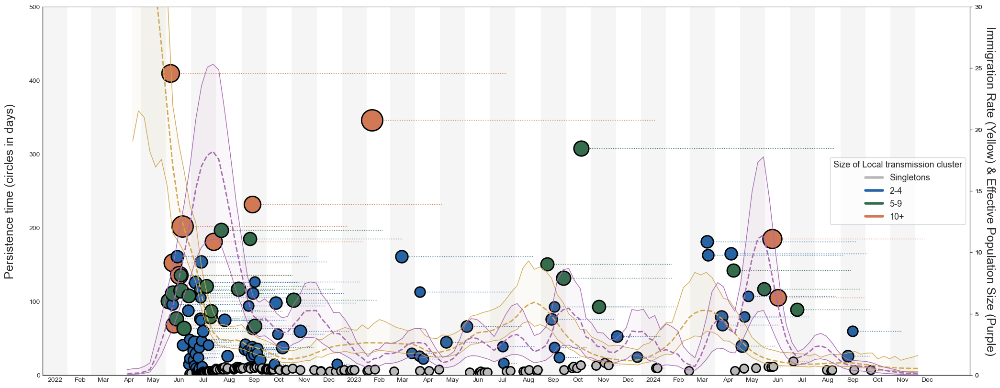

In [178]:
fig,ax = plt.subplots(figsize=(25,10),facecolor='w')


    
# set blank white face for background    
ax.set_facecolor('white')
# remove grid 
ax.grid(False)


for index, values in migrations_for_plot.iterrows():
   # print(index)
    clust = index + 10
    if values.size_of_chain <2:
        col = colors[5]
    elif (values.size_of_chain >1) & (values.size_of_chain <5):
        col = colors[1]
    elif (values.size_of_chain >4) & (values.size_of_chain <11):
        col = colors[4]
    else:
        col = colors[3]
    linewidth = 3
    persist_days = decimal_to_days(values.chain_latest_tip - values.date)
    radius = np.sqrt(values.size_of_chain/np.pi)*300.0
    
    ax.scatter(values.date,persist_days,s=radius,facecolor=col,edgecolor='k',lw=2,zorder=200) ## add big circle at base of tree to indicate origin
    ax.plot([values.date, values.chain_latest_tip], [persist_days, persist_days], color=col, linewidth=1, linestyle = ":")

ax.set_ylabel('Persistence time (circles in days)', fontsize=18,  labelpad=20)
   
fc = colors[0]
ec = colors[0]
ax2 = ax.twinx()

ax2.plot(test_mig.decimal_date,test_mig["mean_mig_linear"],color=fc,ls='--',lw=2)

#ax.scatter(caseDates,[0.0]*len(caseDates),alpha=0.2,s=200,marker='|',lw=3,facecolor='k',zorder=100)
ax2.fill_between(test_mig.decimal_date,test_mig.lower_hpd_linear_50,test_mig.upper_hpd_linear_50,alpha=0.05,facecolor=fc,edgecolor=ec,zorder=1000)
ax2.plot(test_mig.decimal_date,test_mig.lower_hpd_linear_50,color=fc,lw=1,zorder=1000)
ax2.plot(test_mig.decimal_date,test_mig.upper_hpd_linear_50,color=fc,lw=1,zorder=1000)
ax2.set_ylim(0,30)



fc = colors[2]
ec = colors[2]
ax3 = ax.twinx()

ax3.plot(test_ne.decimal_date,test_ne["mean_Ne_linear_MA"],color=fc,ls='--',lw=2)

#ax.scatter(caseDates,[0.0]*len(caseDates),alpha=0.2,s=200,marker='|',lw=3,facecolor='k',zorder=100)


ax3.fill_between(test_ne.decimal_date,test_ne.lower_hpd_linear_50_MA,test_ne.upper_hpd_linear_50_MA,alpha=0.05,facecolor=fc,edgecolor=ec,zorder=1000)
ax3.plot(test_ne.decimal_date,test_ne.lower_hpd_linear_50_MA,color=fc,lw=1,zorder=1000)
ax3.plot(test_ne.decimal_date,test_ne.upper_hpd_linear_50_MA,color=fc,lw=1,zorder=1000)
ax3.set_ylim(0,30)
ax3.set_ylabel('Importation Rate (Yellow) & Effective Population Size (Purple)', fontsize=18, rotation = -90, labelpad=20)

    #ax.scatter([values.parent_tmrca, values.chain_tmrca], [clust, clust], color=col, linewidth=linewidth)
    #ax.plot([values.chain_tmrca, values.chain_latest_tip], [clust, clust], color=col, linewidth=1, linestyle = ":")

   # ax.plot([mrca[0], mrca[1]], [clust, clust], color=col, linewidth=linewidth)
    # add small vertical lines at the start and end of each mrca
    # ax.plot([mrca[0], mrca[0]], [clust-0.2, clust+0.2], color=col, linewidth=1)
    # ax.plot([mrca[1], mrca[1]], [clust-0.2, clust+0.2], color=col, linewidth=1)

# # set ylabel, with a long arrow at the end
#ax.set_ylabel('Importation (from earliest to latest) →', fontsize=fontsize)

legend_list = [mlines.Line2D([0], [0], color=colors[5], lw=4, label='Singletons'),
                mlines.Line2D([0], [0], color=colors[1], lw=4, label='2-4'),
                mlines.Line2D([0], [0], color=colors[4], lw=4, label='5-9'),
                mlines.Line2D([0], [0], color=colors[3], lw=4, label='10+')]
ax.legend(handles=legend_list, title='Size of Local transmission cluster', fontsize=13, title_fontsize=13, loc='center right')

xDates=['%04d-%02d-01'%(y,m) for y in range(2022,2025) for m in range(1,13)]
xDates2=['%04d-%02d-01'%(y,m) for y in range(2022,2025) for m in range(1,13)]


every=1
[ax.axvspan(bt.decimalDate(xDates2[x]),bt.decimalDate(xDates2[x])+1/float(12),facecolor='k',edgecolor='none',alpha=0.04) for x in range(0,len(xDates2),2)]
ax.set_xticks([bt.decimalDate(x)+1/24.0 for x in xDates if (int(x.split('-')[1])-1)%every==0])

ax.set_xticklabels([convertDate(x,'%Y-%m-%d','%Y') if x.split('-')[1]=='01' else convertDate(x,'%Y-%m-%d','%b') for x in xDates if (int(x.split('-')[1])-1)%every==0])
ax.tick_params(axis='x',labelsize=10,size=0)  

#ax1.xaxis.tick_bottom()
ax.yaxis.tick_left()

[ax2.spines[loc].set_visible(False) for loc in ['top',]]
[ax.spines[loc].set_visible(False) for loc in ['top','right']]

ax.tick_params(axis='y',size=0)
#ax.set_yticklabels([])
ax.set_ylim(0,500)
ax.set_xlim(2022,2025.1)

ax.xaxis.set_tick_params(which='both', top=False, bottom=True, labelbottom=True)
ax.yaxis.set_tick_params(which='both', right=False, left=True, labelleft=True)
plt.savefig('../figures/mpox_la_introduction_persistence_with_ne.png',dpi=300,bbox_inches='tight')


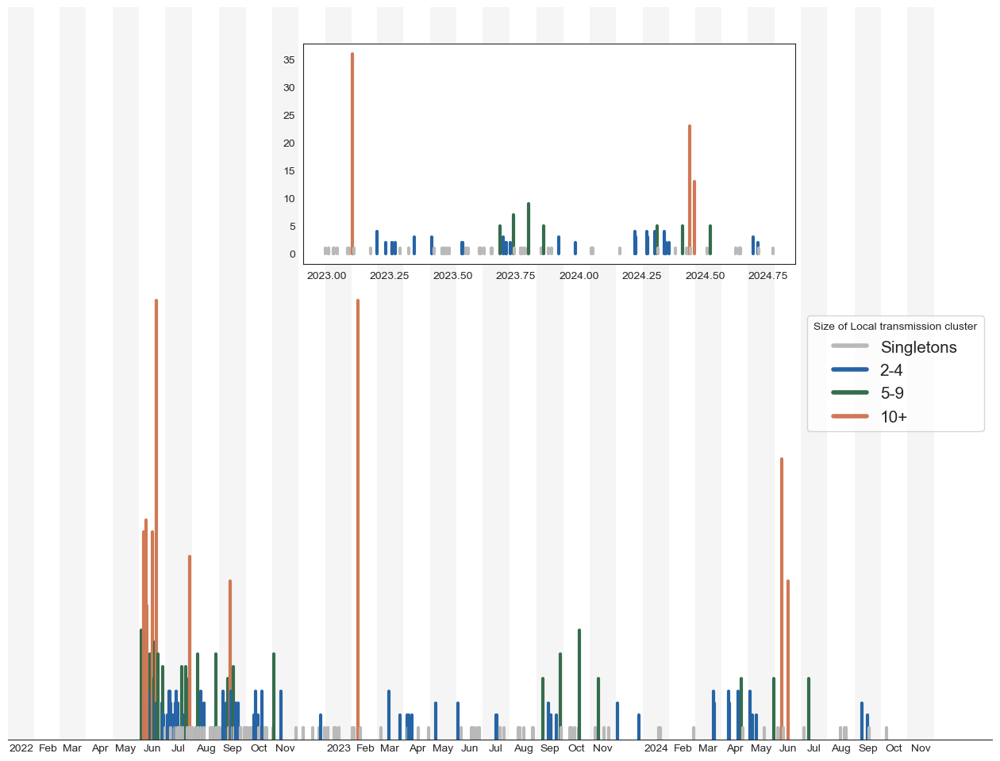

In [179]:
fig,ax = plt.subplots(figsize=(16,12),facecolor='w')

ins_ax = ax.inset_axes([.3, .65, .5, .3])  # [x, y, width, height] w.r.t. ax
    
# set blank white face for background    
ax.set_facecolor('white')
# remove grid 
ax.grid(False)


for index, values in migrations_for_plot.iterrows():
   # print(index)
    clust = index + 10
    if values.size_of_chain <2:
        col = colors[5]
    elif (values.size_of_chain >1) & (values.size_of_chain <5):
        col = colors[1]
    elif (values.size_of_chain >4) & (values.size_of_chain <11):
        col = colors[4]
    else:
        col = colors[3]
    linewidth = 3
    
    ax.plot([values.date, values.date], [0, values.size_of_chain], color=col, linewidth=linewidth)
    #ax.plot([values.chain_tmrca, values.chain_latest_tip], [0, clust], color=col, linewidth=1, linestyle = ":")

   # ax.plot([mrca[0], mrca[1]], [clust, clust], color=col, linewidth=linewidth)
    # add small vertical lines at the start and end of each mrca
    # ax.plot([mrca[0], mrca[0]], [clust-0.2, clust+0.2], color=col, linewidth=1)
    # ax.plot([mrca[1], mrca[1]], [clust-0.2, clust+0.2], color=col, linewidth=1)

# # set ylabel, with a long arrow at the end
#ax.set_ylabel('Importation (from earliest to latest) →', fontsize=fontsize)


    if values.date > 2022.99:
    
        ins_ax.plot([values.date, values.date], [0, values.size_of_chain], color=col, linewidth=linewidth)
#plt.xticks([]); plt.yticks([])  # strip ticks, which collide w/ main ax


legend_list = [mlines.Line2D([0], [0], color=colors[5], lw=4, label='Singletons'),
                mlines.Line2D([0], [0], color=colors[1], lw=4, label='2-4'),
                mlines.Line2D([0], [0], color=colors[4], lw=4, label='5-9'),
                mlines.Line2D([0], [0], color=colors[3], lw=4, label='10+')]
ax.legend(handles=legend_list, title='Size of Local transmission cluster', fontsize=15, title_fontsize=10, loc='center right')

xDates=['%04d-%02d-01'%(y,m) for y in range(2022,2025) for m in range(1,12)]
xDates2=['%04d-%02d-01'%(y,m) for y in range(2022,2025) for m in range(1,13)]


every=1
[ax.axvspan(bt.decimalDate(xDates2[x]),bt.decimalDate(xDates2[x])+1/float(12),facecolor='k',edgecolor='none',alpha=0.04) for x in range(0,len(xDates2),2)]
ax.set_xticks([bt.decimalDate(x)+1/24.0 for x in xDates if (int(x.split('-')[1])-1)%every==0])

ax.set_xticklabels([convertDate(x,'%Y-%m-%d','%Y') if x.split('-')[1]=='01' else convertDate(x,'%Y-%m-%d','%b') for x in xDates if (int(x.split('-')[1])-1)%every==0])
ax.tick_params(axis='x',labelsize=10,size=0)  

#ax1.xaxis.tick_bottom()
ax.yaxis.tick_left()

[ax.spines[loc].set_visible(False) for loc in ['top','right','left']]

ax.tick_params(axis='y',size=0)
ax.set_yticklabels([])
ax.set_ylim(0,60)
ax.set_xlim(2022,2025.1)

ax.xaxis.set_tick_params(which='both', top=False, bottom=True, labelbottom=True)
ax.yaxis.set_tick_params(which='both', right=False, left=True, labelleft=True)

In [180]:
migrations_for_plot["clust_cat"] = "Singletons"
#migrations_for_plot.clust_cat[migrations_for_plot.size_of_chain <2] = 1
migrations_for_plot.clust_cat[(migrations_for_plot.size_of_chain >1) & (migrations_for_plot.size_of_chain <5)] = "2-4"
migrations_for_plot.clust_cat[(migrations_for_plot.size_of_chain >4) & (migrations_for_plot.size_of_chain <11)] = "5-9"
migrations_for_plot.clust_cat[migrations_for_plot.size_of_chain >10] = "10+"



/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/850288200.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  migrations_for_plot.clust_cat[(migrations_for_plot.size_of_chain >1) & (migrations_for_plot.size_of_chain <5)] = "2-4"
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/850288200.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  migrations_for_plot.clust_cat[(migrations_for_plot.size_of_chain >4) & (migrations_for_plot.size_of_chain <11)] = "5-9"
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/850288200.py:5: SettingWithCopyWarning: 
A value is trying to be set on

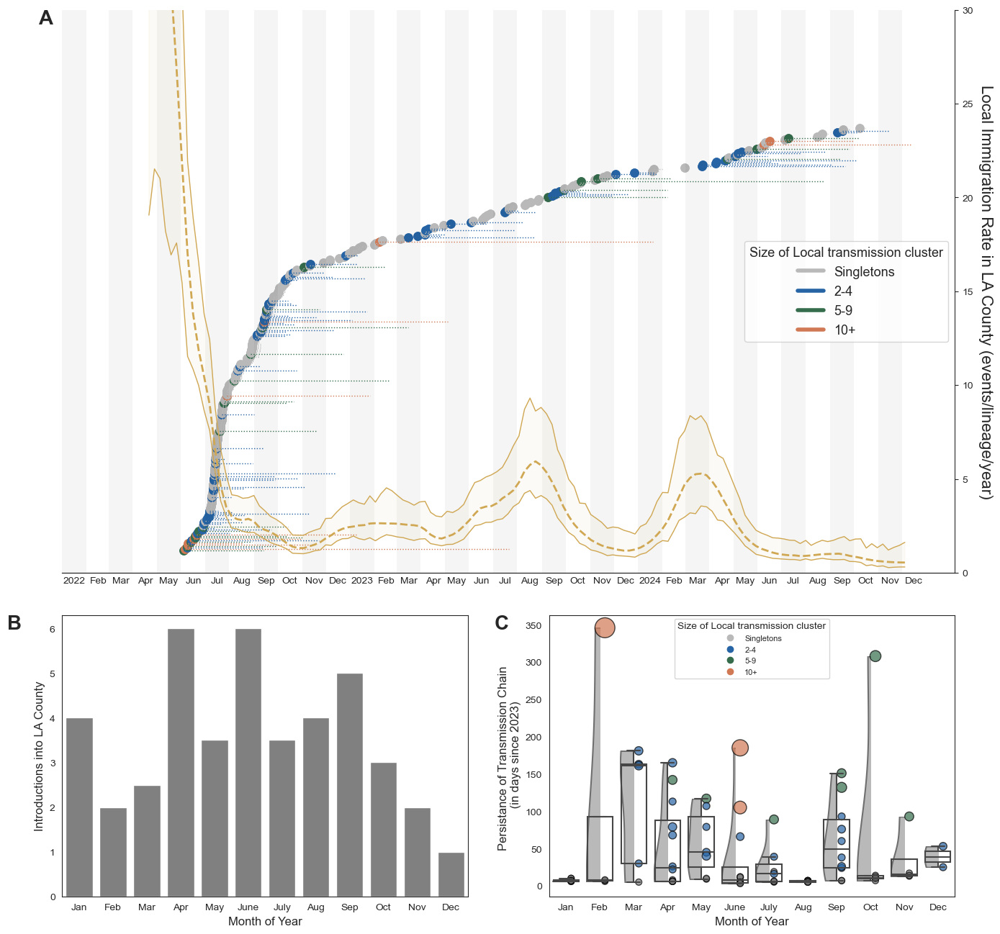

In [181]:
fig = plt.figure(figsize=(16,16),facecolor='w')


gs = GridSpec(2, 2, height_ratios=[2, 1], width_ratios=[1, 1], hspace=0.1)  

# Add the first subplot (main plot with all the identified introductions)
ax1 = fig.add_subplot(gs[0, :])

# set blank white face for background    
ax1.set_facecolor('white')

# remove grid 
ax1.grid(False)

# plot each introduction
for index, values in migrations_for_plot.iterrows():
   # print(index)
    clust = index + 10
    if values.size_of_chain <2:
        col = colors[5]
    elif (values.size_of_chain >1) & (values.size_of_chain <5):
        col = colors[1]
    elif (values.size_of_chain >4) & (values.size_of_chain <11):
        col = colors[4]
    else:
        col = colors[3]
    linewidth = 3
    
    ax1.scatter([values.date, values.date], [clust, clust], color=col, linewidth=linewidth)
    ax1.plot([values.date, values.chain_latest_tip], [clust, clust], color=col, linewidth=1, linestyle = ":")

fc = colors[0]
ec = colors[0]

# plot the rate of introduction into LA County
ax2 = ax1.twinx()

#first plot the mean
ax2.plot(test_mig.decimal_date,test_mig["mean_mig_linear"],color=fc,ls='--',lw=2)

# then the bounds
ax2.fill_between(test_mig.decimal_date,test_mig.lower_hpd_linear_50,test_mig.upper_hpd_linear_50,alpha=0.05,facecolor=fc,edgecolor=ec,zorder=1000)
ax2.plot(test_mig.decimal_date,test_mig.lower_hpd_linear_50,color=fc,lw=1,zorder=1000)
ax2.plot(test_mig.decimal_date,test_mig.upper_hpd_linear_50,color=fc,lw=1,zorder=1000)
ax2.set_ylim(0,30)
ax2.set_ylabel('Local Importation Rate in LA County (events/lineage/year)', fontsize=16, rotation = -90, labelpad=20)

fc = colors[2]
ec = colors[2]

legend_list = [mlines.Line2D([0], [0], color=colors[5], lw=4, label='Singletons'),
                mlines.Line2D([0], [0], color=colors[1], lw=4, label='2-4'),
                mlines.Line2D([0], [0], color=colors[4], lw=4, label='5-9'),
                mlines.Line2D([0], [0], color=colors[3], lw=4, label='10+')]
ax1.legend(handles=legend_list, title='Size of Local transmission cluster', fontsize=13, title_fontsize=13, loc='center right')

xDates=['%04d-%02d-01'%(y,m) for y in range(2022,2025) for m in range(1,13)]
xDates2=['%04d-%02d-01'%(y,m) for y in range(2022,2025) for m in range(1,13)]


every=1
[ax1.axvspan(bt.decimalDate(xDates2[x]),bt.decimalDate(xDates2[x])+1/float(12),facecolor='k',edgecolor='none',alpha=0.04) for x in range(0,len(xDates2),2)]
ax1.set_xticks([bt.decimalDate(x)+1/24.0 for x in xDates if (int(x.split('-')[1])-1)%every==0])

ax1.set_xticklabels([convertDate(x,'%Y-%m-%d','%Y') if x.split('-')[1]=='01' else convertDate(x,'%Y-%m-%d','%b') for x in xDates if (int(x.split('-')[1])-1)%every==0])
ax1.tick_params(axis='x',labelsize=10,size=0)  
ax1.yaxis.tick_left()

[ax2.spines[loc].set_visible(False) for loc in ['top','left']]
[ax1.spines[loc].set_visible(False) for loc in ['top','right','left']]

ax1.tick_params(axis='y',size=0)
ax1.set_yticklabels([])
ax1.set_ylim(-5,clust+80)
ax1.set_xlim(2022,2025.1)

ax1.xaxis.set_tick_params(which='both', top=False, bottom=True, labelbottom=True)
ax1.yaxis.set_tick_params(which='both', right=False, left=True, labelleft=True)

#add in panel label 
ax1.text(-0.01, 1, "A", transform=ax1.transAxes, fontsize=20, fontweight='bold', va='top', ha='right')  # Panel label


## now add in the number of importations per month (bottom left subplot) 
ax3 = fig.add_subplot(gs[1, 0])

#no_second_year = ["09", "10", "11", "12"]
no_second_year = []
monthly_counts = migrations_for_plot[migrations_for_plot.date >2023].groupby('month').size().reset_index(name='counts')
for index, row in monthly_counts.iterrows():
    if row.month not in no_second_year:
        monthly_counts.loc[index, "counts"] = monthly_counts.loc[index, "counts"]/2
# Plot histogram
sns.barplot(x='month', y='counts', data=monthly_counts, color = "gray", ax = ax3)

# Adjust plot aesthetics
#ax3.xticks(rotation=45, ha='right', fontsize=8)  # Rotate x-axis labels
#ax3.title("Introductions per Month (since 2023)")
ax3.set_xlabel("Month of Year", fontsize=12)
ax3.set_ylabel("Introductions into LA County", fontsize=12)
ax3.set_xticklabels(["Jan", "Feb", "Mar", "Apr", "May", "June", "July", "Aug", "Sep", "Oct", "Nov", "Dec"])

#add in panel label 
ax3.text(-0.1, 1, "B", transform=ax3.transAxes, fontsize=20, fontweight='bold', va='top', ha='right') 




## plotting persistence time for each month (bottom right subplot)
ax4 = fig.add_subplot(gs[1, 1])

migrations_for_plot_2 = migrations_for_plot.sort_values(by=['month']).reset_index() ## this is done to organize the x axis

# fig,ax = plt.subplots(figsize=(25,10),facecolor='w')

sns.set_style('white')
palette = 'Set2'

# estimate persistence
migrations_for_plot_2["persist_days"] = (migrations_for_plot_2.chain_latest_tip - migrations_for_plot_2.date).apply(decimal_to_days)

#plot distribution of persistence times
sns.violinplot(x="month", y="persist_days", data=migrations_for_plot_2[migrations_for_plot_2.date >2023],  dodge=False,
                    palette = [colors[5]] * 12 ,
                    scale="width", inner=None, cut = 0, saturation = 0, ax = ax4 )
xlim = ax4.get_xlim()
ylim = ax4.get_ylim()

#cut off half of the violin plot for the raincloud plot
for violin in ax4.collections:
    bbox = violin.get_paths()[0].get_extents()
    x0, y0, width, height = bbox.bounds
    violin.set_clip_path(plt.Rectangle((x0, y0), width/2, height, transform=ax4.transData))

#make the boxplot with the same data
sns.boxplot(x="month", y="persist_days", data=migrations_for_plot_2[migrations_for_plot_2.date >2023], saturation=1, showfliers=False,
            width=0.75, boxprops={'zorder': 3, 'facecolor': 'none'}, ax=ax4)
old_len_collections = len(ax4.collections)

#now add in the actual scatterpoints
sns.scatterplot(x="month", y="persist_days", hue="clust_cat", size="size_of_chain",
            sizes=(40, 400), alpha=0.7, linewidth = 1,edgecolor = "k", palette=["gray",  colors[3] , colors[1],colors[4],],
             data=migrations_for_plot_2[migrations_for_plot_2.date >2023], ax=ax4)

for dots in ax4.collections[old_len_collections:]:
    dots.set_offsets(dots.get_offsets() + np.array([0.15, 0]))
    
ax4.set_xlim(xlim)
ax4.set_ylim(ylim)

legend_list = [mlines.Line2D([], [], color=colors[5], lw=0, label='Singletons', marker = "o"),
                mlines.Line2D([0], [0], color=colors[1], lw=0, label='2-4', marker = "o"),
                mlines.Line2D([0], [0], color=colors[4], lw=0, label='5-9', marker = "o"),
                mlines.Line2D([0], [0], color=colors[3], lw=0, label='10+', marker = "o")]

ax4.legend(handles = legend_list,title='Size of Local transmission cluster', fontsize=8, title_fontsize=10, loc='upper center')
ax4.set_ylabel('Persistance of Transmission Chain \n (in days since 2023)', fontsize=12)
ax4.set_xlabel('Month of Year', fontsize = 12)
ax4.set_xticklabels(["Jan", "Feb", "Mar", "Apr", "May", "June", "July", "Aug", "Sep", "Oct", "Nov", "Dec"])

#add in panel label 
ax4.text(-0.1, 1, "C", transform=ax4.transAxes, fontsize=20, fontweight='bold', va='top', ha='right')  


plt.savefig('../figures/mpox_la_introduction_figure.png',dpi=300,bbox_inches='tight')


In [182]:
start_time = time.time()

mig = return_proportions_dataframe(migrations_df, "year-week")

total_time_seconds = time.time() - start_time
total_time_minutes = total_time_seconds/60
print(total_time_minutes)

mig.head()

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

1.5886814792950947


/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(to_add)
/var/folders/h9/0347drb57tsgxzbddmvmlvf80000gp/T/ipykernel_9068/698280845.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.app

,migration_direction,year-week,tree_number,total_transitions,transitions_in_time_interval,proportion_transitions_in_time_interval
0,0.0-to-1.0,2023-11-27,139,287,1,0.003484
0,0.0-to-1.0,2023-08-07,139,287,1,0.003484
0,0.0-to-1.0,2023-02-20,139,287,0,0.000000
0,0.0-to-1.0,2022-07-25,139,287,14,0.048780
0,0.0-to-1.0,2022-07-18,139,287,22,0.076655


In [183]:
mig.reset_index(inplace = True, drop = True)


In [184]:
mig.head()

,migration_direction,year-week,tree_number,total_transitions,transitions_in_time_interval,proportion_transitions_in_time_interval
0,0.0-to-1.0,2023-11-27,139,287,1,0.003484
1,0.0-to-1.0,2023-08-07,139,287,1,0.003484
2,0.0-to-1.0,2023-02-20,139,287,0,0.000000
3,0.0-to-1.0,2022-07-25,139,287,14,0.048780
4,0.0-to-1.0,2022-07-18,139,287,22,0.076655


In [185]:
alt.Chart(mig, width = 750).mark_line( opacity = 1).encode(
    x=alt.X('year-week:T'),
    y=alt.Y('mean(transitions_in_time_interval):Q'))

alt.Chart(...)

In [197]:
error_bars = alt.Chart(mig).mark_errorbar(size = 100 , extent='ci').encode(
  x=alt.X('year-week:T', axis = alt.Axis(grid = False)),
  y=alt.Y('transitions_in_time_interval:Q', title = "Viral introductions into LA", axis = alt.Axis(grid = False))
).properties(
    width=800,
    height=300
)

points = alt.Chart(mig).mark_point(filled=True,  opacity = 0.55).encode(
  x=alt.X('year-week:T'),
  y=alt.Y('transitions_in_time_interval:Q', aggregate='mean')
).properties(
    width=800,
    height=300
)

lineplot4 =  alt.Chart(mig).mark_line(interpolate='monotone', opacity = 0.35).encode(
    x=alt.X('year-week:T'),
    y=alt.Y('mean(transitions_in_time_interval)')).properties(
    width=800,
    height=300
)


ave = error_bars + points +lineplot4
ave

alt.LayerChart(...)

In [187]:
mig.transitions_in_time_interval

0         1
1         1
2         0
3        14
4        22
         ..
41985     1
41986     2
41987    10
41988     1
41989     5
Name: transitions_in_time_interval, Length: 41990, dtype: int64

In [188]:
mig_to_export = mig[["year-week", "tree_number", "total_transitions", "transitions_in_time_interval"]]; mig_to_export.head()

,year-week,tree_number,total_transitions,transitions_in_time_interval
0,2023-11-27,139,287,1
1,2023-08-07,139,287,1
2,2023-02-20,139,287,0
3,2022-07-25,139,287,14
4,2022-07-18,139,287,22


In [189]:
mig_to_export.to_csv("mpox_la_introductions_over_time.csv", sep = ",")

In [190]:
stats = mig_to_export.groupby("year-week")["transitions_in_time_interval"].agg(['mean', 'sem'])
stats['ci95_hi'] = stats['mean'] + 1.96* stats['sem']
stats['ci95_lo'] = stats['mean'] - 1.96* stats['sem']
print(stats)

                mean       sem   ci95_hi   ci95_lo
year-week                                         
2022-04-25  0.018576  0.007524  0.033324  0.003828
2022-05-02  0.114551  0.021204  0.156111  0.072991
2022-05-09  0.244582  0.030330  0.304029  0.185135
2022-05-16  0.609907  0.050653  0.709187  0.510628
2022-05-23  1.269350  0.075672  1.417667  1.121032
...              ...       ...       ...       ...
2024-09-16  0.894737  0.043236  0.979479  0.809995
2024-09-23  0.588235  0.040457  0.667531  0.508939
2024-09-30  0.188854  0.021811  0.231605  0.146104
2024-10-07  0.386997  0.027143  0.440197  0.333797
2024-10-14  0.164087  0.020639  0.204539  0.123634

[130 rows x 4 columns]


In [191]:
stats.reset_index(inplace= True)

In [192]:
stats['mean'].tolist()

[0.018575851393188854,
 0.11455108359133127,
 0.24458204334365324,
 0.6099071207430341,
 1.2693498452012384,
 2.7151702786377707,
 4.284829721362229,
 5.975232198142415,
 7.08359133126935,
 12.309597523219814,
 19.8297213622291,
 29.513931888544892,
 19.88235294117647,
 12.969040247678018,
 8.303405572755418,
 6.585139318885449,
 6.808049535603715,
 6.352941176470588,
 7.291021671826625,
 7.913312693498452,
 5.486068111455109,
 6.578947368421052,
 6.386996904024768,
 5.238390092879257,
 3.7708978328173375,
 2.6873065015479876,
 1.86687306501548,
 1.368421052631579,
 1.2198142414860682,
 1.108359133126935,
 0.804953560371517,
 1.1393188854489165,
 1.520123839009288,
 1.0371517027863777,
 1.3715170278637772,
 1.609907120743034,
 1.9009287925696594,
 1.5356037151702786,
 1.3715170278637772,
 0.6253869969040248,
 0.9907120743034056,
 1.0959752321981424,
 0.7832817337461301,
 0.43343653250773995,
 0.5046439628482973,
 0.9287925696594427,
 0.5820433436532507,
 0.826625386996904,
 1.136222910

In [193]:
stats.to_csv("mpox_la_introductions_stats.csv", sep = ",")